In [1]:
# import dependencies
import pandas as pd
import numpy as np
import requests
import json
import geopandas as gpd
import geoplot as gplt
import matplotlib.pyplot as plt
import mapclassify as mc
import warnings
warnings.filterwarnings('ignore')
from scipy.stats import linregress

In [2]:
# !pip install geopandas
# !pip install geoplot
# !pip install mapclassify

In [3]:
# open data api key for multiple chronic diseases from CDC
base_url = "https://data.cms.gov/data-api/v1/dataset/b736b4bd-3020-4343-b3dc-0010082ccc77/data?"

In [4]:
# To retrieve large json data
json_data = []  # To store all the data

# Set up pagination
page = 0
page_size = 5000  # Adjust the page size 

while True:
    query_url = f"{base_url}size={page_size}&offset={page}"
    response = requests.get(query_url).json()
    json_data.extend(response)

    if len(json_data) < page:
        # Break the loop if all data has been retrieved
        break

    page += page_size

In [5]:
# Convert data into a Pandas DataFrame
mcc_df = pd.DataFrame(json_data)
mcc_df

,Bene_Geo_Lvl,Bene_Geo_Desc,Bene_Geo_Cd,Bene_Age_Lvl,Bene_Demo_Lvl,Bene_Demo_Desc,Bene_MCC,Prvlnc,Tot_Mdcr_Stdzd_Pymt_PC,Tot_Mdcr_Pymt_PC,Hosp_Readmsn_Rate,ER_Visits_Per_1000_Benes
0,State,Alabama,01,65+,All,All,0 to 1,0.2318,1999.566,1806.2546,0.0464,127.2703
1,State,Alabama,01,65+,All,All,2 to 3,0.2911,5198.6566,4738.4133,0.0589,307.573
2,State,Alabama,01,65+,All,All,4 to 5,0.2604,9896.6809,9017.293,0.0936,576.8055
3,State,Alabama,01,65+,All,All,6+,0.2168,27177.0547,24715.7787,0.2071,1594.5694
4,State,Alabama,01,65+,Dual Status,Medicare Only,0 to 1,0.2473,1982.6565,1790.6022,0.0468,117.0981
...,...,...,...,...,...,...,...,...,...,...,...,...
44971,County,Wyoming : Washakie,56043,65+,All,All,6+,0.0983,41050.5844,47269.2138,0.2679,3116.8831
44972,County,Wyoming : Weston,56045,65+,All,All,0 to 1,,,,,
44973,County,Wyoming : Weston,56045,65+,All,All,2 to 3,,,,,
44974,County,Wyoming : Weston,56045,65+,All,All,4 to 5,,,,,


In [6]:
mcc_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44976 entries, 0 to 44975
Data columns (total 12 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Bene_Geo_Lvl              44976 non-null  object
 1   Bene_Geo_Desc             44976 non-null  object
 2   Bene_Geo_Cd               44976 non-null  object
 3   Bene_Age_Lvl              44976 non-null  object
 4   Bene_Demo_Lvl             44976 non-null  object
 5   Bene_Demo_Desc            44976 non-null  object
 6   Bene_MCC                  44976 non-null  object
 7   Prvlnc                    44976 non-null  object
 8   Tot_Mdcr_Stdzd_Pymt_PC    44976 non-null  object
 9   Tot_Mdcr_Pymt_PC          44976 non-null  object
 10  Hosp_Readmsn_Rate         44976 non-null  object
 11  ER_Visits_Per_1000_Benes  44976 non-null  object
dtypes: object(12)
memory usage: 4.1+ MB


In [7]:
# Rename all the columns to descriptive columns
mcc_df = mcc_df.rename(columns = {
    "Bene_Geo_Lvl": "Beneficiary_Geographic_Level",
    "Bene_Geo_Desc" : "Beneficiary_Geographic_Description",
    "Bene_Geo_Cd" : "Beneficiary_Geographic_Code",
    "Bene_Age_Lvl" : "Beneficiary_Age_Level",
    "Bene_Demo_Lvl" : "Beneficiary_Demographic_Level",
    "Bene_Demo_Desc" : "Beneficiary_Demographic_Description",
    "Bene_MCC" : "Beneficiary_Multiple_Chronic_Condition_Group",
    "Prvlnc" : "Prevalence",
    "Tot_Mdcr_Stdzd_Pymt_PC" : "Total_Medicare_Standardized_Per_Capita_Spending",
    "Tot_Mdcr_Pymt_PC" : "Total_Medicare_Per_Capita_Spending",
    "Hosp_Readmsn_Rate" : "Hospital_Readmission_Rate",
    "ER_Visits_Per_1000_Benes" : "Emergency_Room_Visits_per_1,000_Beneficiaries",
})
mcc_df

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
0,State,Alabama,01,65+,All,All,0 to 1,0.2318,1999.566,1806.2546,0.0464,127.2703
1,State,Alabama,01,65+,All,All,2 to 3,0.2911,5198.6566,4738.4133,0.0589,307.573
2,State,Alabama,01,65+,All,All,4 to 5,0.2604,9896.6809,9017.293,0.0936,576.8055
3,State,Alabama,01,65+,All,All,6+,0.2168,27177.0547,24715.7787,0.2071,1594.5694
4,State,Alabama,01,65+,Dual Status,Medicare Only,0 to 1,0.2473,1982.6565,1790.6022,0.0468,117.0981
...,...,...,...,...,...,...,...,...,...,...,...,...
44971,County,Wyoming : Washakie,56043,65+,All,All,6+,0.0983,41050.5844,47269.2138,0.2679,3116.8831
44972,County,Wyoming : Weston,56045,65+,All,All,0 to 1,,,,,
44973,County,Wyoming : Weston,56045,65+,All,All,2 to 3,,,,,
44974,County,Wyoming : Weston,56045,65+,All,All,4 to 5,,,,,


In [8]:
# changing the datatype from object to numeric (float as default)
mcc_df[["Prevalence","Total_Medicare_Standardized_Per_Capita_Spending", \
               "Total_Medicare_Per_Capita_Spending", "Hospital_Readmission_Rate", \
              "Emergency_Room_Visits_per_1,000_Beneficiaries"]] = \
mcc_df[["Prevalence","Total_Medicare_Standardized_Per_Capita_Spending", \
               "Total_Medicare_Per_Capita_Spending", "Hospital_Readmission_Rate", \
              "Emergency_Room_Visits_per_1,000_Beneficiaries"]].apply(pd.to_numeric, errors='coerce')

In [9]:
print(mcc_df.shape)
mcc_df.info()

(44976, 12)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44976 entries, 0 to 44975
Data columns (total 12 columns):
 #   Column                                           Non-Null Count  Dtype  
---  ------                                           --------------  -----  
 0   Beneficiary_Geographic_Level                     44976 non-null  object 
 1   Beneficiary_Geographic_Description               44976 non-null  object 
 2   Beneficiary_Geographic_Code                      44976 non-null  object 
 3   Beneficiary_Age_Level                            44976 non-null  object 
 4   Beneficiary_Demographic_Level                    44976 non-null  object 
 5   Beneficiary_Demographic_Description              44976 non-null  object 
 6   Beneficiary_Multiple_Chronic_Condition_Group     44976 non-null  object 
 7   Prevalence                                       41260 non-null  float64
 8   Total_Medicare_Standardized_Per_Capita_Spending  41232 non-null  float64
 9   Total_Medicare_P

## Beneficiary geographical level is at analyzed at National, State and County level. Observing and analyzing at State and county level mainly

### Observing the dataset at National level

In [10]:
# Make a dataframe based on National
mcc_national_df = mcc_df.loc[mcc_df["Beneficiary_Geographic_Level"] == "National"]
mcc_national_df = mcc_national_df.reset_index(drop=True)
#pd.set_option("display.max_rows", None, "display.max_columns", None)
mcc_national_df

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
0,National,National,,65+,All,All,0 to 1,0.2990,1864.5824,1890.0697,0.0448,125.2986
1,National,National,,65+,All,All,2 to 3,0.2957,5266.8693,5451.3164,0.0612,324.0907
2,National,National,,65+,All,All,4 to 5,0.2263,10178.9293,10714.2818,0.0941,633.0037
3,National,National,,65+,All,All,6+,0.1790,28548.8447,30688.9773,0.2134,1747.8357
4,National,National,,65+,Dual Status,Medicare Only,0 to 1,0.3167,1867.0045,1887.5742,0.0434,118.4731
...,...,...,...,...,...,...,...,...,...,...,...,...
115,National,National,,All,Race,non-Hispanic Black,6+,0.2086,35347.0002,38682.4957,0.2745,2624.5654
116,National,National,,All,Race,non-Hispanic White,0 to 1,0.3093,2085.4058,2096.6901,0.0538,168.9387
117,National,National,,All,Race,non-Hispanic White,2 to 3,0.2977,5633.3032,5788.3665,0.0695,387.1976
118,National,National,,All,Race,non-Hispanic White,4 to 5,0.2203,10660.3522,11131.0462,0.1012,716.0436


### Observing the dataset at State level

In [11]:
# summary statistics of national level data
mcc_national_df.describe()

,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
count,120.000000,120.000000,120.000000,120.000000,120.000000
mean,0.250002,13047.275507,14132.265408,0.133844,1052.779237
std,0.071173,11966.192975,13247.849338,0.078122,943.700769
min,0.110300,1135.560800,1183.622100,0.042600,83.381900
25%,0.189875,3551.087925,3905.361700,0.070525,367.282600
50%,0.248700,8422.653600,9256.054150,0.106500,686.919950
75%,0.296650,18731.692125,21206.373850,0.194650,1643.022400
max,0.437800,41630.397800,48584.000800,0.330000,3853.589800


In [12]:
# State level needs three steps of filtering based on state, age level - all category and demography level - all
state_s = mcc_df["Beneficiary_Geographic_Level"] == "State"
beneficiary_age_all_s = mcc_df["Beneficiary_Age_Level"] == "All"
beneficiary_demo_all_s = mcc_df["Beneficiary_Demographic_Level"] == "All"
state_age_demo_s = state_s & beneficiary_age_all_s & beneficiary_demo_all_s
state_age_demo_s

0        False
1        False
2        False
3        False
4        False
         ...  
44971    False
44972    False
44973    False
44974    False
44975    False
Length: 44976, dtype: bool

In [13]:
print(mcc_df.columns)

Index(['Beneficiary_Geographic_Level', 'Beneficiary_Geographic_Description',
       'Beneficiary_Geographic_Code', 'Beneficiary_Age_Level',
       'Beneficiary_Demographic_Level', 'Beneficiary_Demographic_Description',
       'Beneficiary_Multiple_Chronic_Condition_Group', 'Prevalence',
       'Total_Medicare_Standardized_Per_Capita_Spending',
       'Total_Medicare_Per_Capita_Spending', 'Hospital_Readmission_Rate',
       'Emergency_Room_Visits_per_1,000_Beneficiaries'],
      dtype='object')


In [14]:
# Make a dataframe based on State
mcc_state_df = mcc_df.loc[state_age_demo_s]
mcc_state_df = mcc_state_df.reset_index(drop=True)
print(mcc_state_df.shape)
mcc_state_df

(216, 12)


,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
0,State,Alabama,01,All,All,All,0 to 1,0.2621,2091.9398,1887.2548,0.0590,226.9723
1,State,Alabama,01,All,All,All,2 to 3,0.2874,5545.1296,5039.7988,0.0814,439.7410
2,State,Alabama,01,All,All,All,4 to 5,0.2481,10383.4301,9451.8262,0.1098,724.2161
3,State,Alabama,01,All,All,All,6+,0.2024,27980.7920,25491.2797,0.2212,1851.6498
4,State,Alaska,02,All,All,All,0 to 1,0.4805,1822.9275,2202.1402,0.0535,163.5787
...,...,...,...,...,...,...,...,...,...,...,...,...
211,State,Wisconsin,55,All,All,All,6+,0.1402,27609.4522,29388.6248,0.2136,2106.1366
212,State,Wyoming,56,All,All,All,0 to 1,0.4806,2081.4474,2174.3732,0.0716,181.1350
213,State,Wyoming,56,All,All,All,2 to 3,0.2781,6656.7032,7278.8866,0.0708,531.2221
214,State,Wyoming,56,All,All,All,4 to 5,0.1503,13389.3162,15018.1410,0.0959,1022.7305


In [15]:
# looking for any missing state code
mcc_state_df["Beneficiary_Geographic_Code"].unique()

array(['01', '02', '04', '05', '06', '08', '09', '10', '11', '12', '13',
       '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25',
       '26', '27', '28', '29', '30', '31', '32', '33', '34', '35', '36',
       '37', '38', '39', '40', '41', '42', '', '44', '45', '46', '47',
       '48', '49', '50', '51', '53', '54', '55', '56'], dtype=object)

In [16]:
# looking for any missing state name or blanks
mcc_state_df["Beneficiary_Geographic_Description"].unique()

array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
       'Colorado', 'Connecticut', 'Delaware', 'District of Columbia',
       'Florida', 'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Indiana',
       'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine', 'Maryland',
       'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi',
       'Missouri', 'Montana', 'Nebraska', 'Nevada', 'New Hampshire',
       'New Jersey', 'New Mexico', 'New York', 'North Carolina',
       'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'Pennsylvania',
       'Puerto Rico', 'Rhode Island', 'South Carolina', 'South Dakota',
       'Tennessee', 'Texas', 'Unknown', 'Utah', 'Vermont',
       'Virgin Islands', 'Virginia', 'Washington', 'West Virginia',
       'Wisconsin', 'Wyoming'], dtype=object)

In [17]:
# filtering for unknown state
filtered_state_df = mcc_state_df[mcc_state_df["Beneficiary_Geographic_Description"] != "Unknown"]
filtered_state_df

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
0,State,Alabama,01,All,All,All,0 to 1,0.2621,2091.9398,1887.2548,0.0590,226.9723
1,State,Alabama,01,All,All,All,2 to 3,0.2874,5545.1296,5039.7988,0.0814,439.7410
2,State,Alabama,01,All,All,All,4 to 5,0.2481,10383.4301,9451.8262,0.1098,724.2161
3,State,Alabama,01,All,All,All,6+,0.2024,27980.7920,25491.2797,0.2212,1851.6498
4,State,Alaska,02,All,All,All,0 to 1,0.4805,1822.9275,2202.1402,0.0535,163.5787
...,...,...,...,...,...,...,...,...,...,...,...,...
211,State,Wisconsin,55,All,All,All,6+,0.1402,27609.4522,29388.6248,0.2136,2106.1366
212,State,Wyoming,56,All,All,All,0 to 1,0.4806,2081.4474,2174.3732,0.0716,181.1350
213,State,Wyoming,56,All,All,All,2 to 3,0.2781,6656.7032,7278.8866,0.0708,531.2221
214,State,Wyoming,56,All,All,All,4 to 5,0.1503,13389.3162,15018.1410,0.0959,1022.7305


In [19]:
# check for territories state code
filtered_state_df.loc[filtered_state_df["Beneficiary_Geographic_Description"] == "Puerto Rico"]

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
156,State,Puerto Rico,,All,All,All,0 to 1,0.3120,950.9322,789.9499,NaN,128.5301
157,State,Puerto Rico,,All,All,All,2 to 3,0.2364,4680.6115,3893.1890,0.1400,375.8651
158,State,Puerto Rico,,All,All,All,4 to 5,0.2556,7872.3560,6635.8695,0.1546,579.7826
159,State,Puerto Rico,,All,All,All,6+,0.1959,15837.3675,13683.2346,0.2384,1240.6473


In [21]:
# check for territories state code
filtered_state_df.loc[filtered_state_df["Beneficiary_Geographic_Description"] == "Virgin Islands"]

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
192,State,Virgin Islands,,All,All,All,0 to 1,0.4794,1061.0723,1087.4327,0.0924,156.9133
193,State,Virgin Islands,,All,All,All,2 to 3,0.3065,3412.3572,3661.2454,0.0892,388.0022
194,State,Virgin Islands,,All,All,All,4 to 5,0.1585,8575.1651,9618.9572,0.2230,748.4924
195,State,Virgin Islands,,All,All,All,6+,0.0556,32195.1615,36558.2015,0.2694,2344.1296


In [22]:
# check dataframe for state name
filtered_state_df["Beneficiary_Geographic_Description"].unique()

array(['Alabama', 'Alaska', 'Arizona', 'Arkansas', 'California',
       'Colorado', 'Connecticut', 'Delaware', 'District of Columbia',
       'Florida', 'Georgia', 'Hawaii', 'Idaho', 'Illinois', 'Indiana',
       'Iowa', 'Kansas', 'Kentucky', 'Louisiana', 'Maine', 'Maryland',
       'Massachusetts', 'Michigan', 'Minnesota', 'Mississippi',
       'Missouri', 'Montana', 'Nebraska', 'Nevada', 'New Hampshire',
       'New Jersey', 'New Mexico', 'New York', 'North Carolina',
       'North Dakota', 'Ohio', 'Oklahoma', 'Oregon', 'Pennsylvania',
       'Puerto Rico', 'Rhode Island', 'South Carolina', 'South Dakota',
       'Tennessee', 'Texas', 'Utah', 'Vermont', 'Virgin Islands',
       'Virginia', 'Washington', 'West Virginia', 'Wisconsin', 'Wyoming'],
      dtype=object)

### Noticed that two states Puerto Rico and Virgin Islands do not have Beneficiary_Geographic_Code mentioned but have data associated with it. Adding a state code would include those two states. 

In [23]:
# Adding the state code of Puerto Rico and Virgin islands
# this function would replace for null or blank values
# Define a mapping dictionary for the replacements
state_code_mapping = {
    "Puerto Rico": "72",
    "Virgin Islands": "78"
}
# Use numpy.where() to replace blanks based on conditions
filtered_state_df['Beneficiary_Geographic_Code'] = np.where(filtered_state_df['Beneficiary_Geographic_Code'].isnull() | filtered_state_df['Beneficiary_Geographic_Code'].eq(''), 
                            filtered_state_df['Beneficiary_Geographic_Description'].map(state_code_mapping), 
                            filtered_state_df['Beneficiary_Geographic_Code'])

In [25]:
# Viewing the dataframe for added state code
filtered_state_df.loc[filtered_state_df["Beneficiary_Geographic_Description"] == "Puerto Rico"]

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
156,State,Puerto Rico,72,All,All,All,0 to 1,0.3120,950.9322,789.9499,NaN,128.5301
157,State,Puerto Rico,72,All,All,All,2 to 3,0.2364,4680.6115,3893.1890,0.1400,375.8651
158,State,Puerto Rico,72,All,All,All,4 to 5,0.2556,7872.3560,6635.8695,0.1546,579.7826
159,State,Puerto Rico,72,All,All,All,6+,0.1959,15837.3675,13683.2346,0.2384,1240.6473


In [26]:
print(filtered_state_df.shape)

(212, 12)


In [27]:
# Drop rows with blanks in the specified column
columns_to_drop = ["Beneficiary_Geographic_Description", "Prevalence", \
                   "Total_Medicare_Standardized_Per_Capita_Spending", \
                   "Total_Medicare_Per_Capita_Spending", "Hospital_Readmission_Rate", \
                   "Emergency_Room_Visits_per_1,000_Beneficiaries"]

filtered_state_df.dropna(subset=columns_to_drop, inplace=True)
print(filtered_state_df.shape)

(211, 12)


In [28]:
# Viewing the dataframe
filtered_state_df

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
0,State,Alabama,01,All,All,All,0 to 1,0.2621,2091.9398,1887.2548,0.0590,226.9723
1,State,Alabama,01,All,All,All,2 to 3,0.2874,5545.1296,5039.7988,0.0814,439.7410
2,State,Alabama,01,All,All,All,4 to 5,0.2481,10383.4301,9451.8262,0.1098,724.2161
3,State,Alabama,01,All,All,All,6+,0.2024,27980.7920,25491.2797,0.2212,1851.6498
4,State,Alaska,02,All,All,All,0 to 1,0.4805,1822.9275,2202.1402,0.0535,163.5787
...,...,...,...,...,...,...,...,...,...,...,...,...
211,State,Wisconsin,55,All,All,All,6+,0.1402,27609.4522,29388.6248,0.2136,2106.1366
212,State,Wyoming,56,All,All,All,0 to 1,0.4806,2081.4474,2174.3732,0.0716,181.1350
213,State,Wyoming,56,All,All,All,2 to 3,0.2781,6656.7032,7278.8866,0.0708,531.2221
214,State,Wyoming,56,All,All,All,4 to 5,0.1503,13389.3162,15018.1410,0.0959,1022.7305


In [29]:
# summary statistics of State level data
filtered_state_df.describe()

,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
count,211.000000,211.000000,211.000000,211.000000,211.000000
mean,0.249706,11921.467982,12694.838072,0.117551,867.768454
std,0.081075,10527.325796,11590.981079,0.065832,728.188865
min,0.055600,1061.072300,1087.432700,0.044800,142.074200
25%,0.188600,3856.739500,3777.217200,0.069700,323.308250
50%,0.249400,7872.356000,7849.250000,0.094800,580.872300
75%,0.295350,14613.341850,15997.919100,0.182200,1139.314600
max,0.480600,34965.464500,42263.488100,0.281200,2833.349800


In [30]:
# GeoJSON data - new test json
#jsonData = requests.get("https://eric.clst.org/assets/wiki/uploads/Stuff/gz_2010_us_050_00_500k.json").json()
jsonData = requests.get("https://raw.githubusercontent.com/PublicaMundi/MappingAPI/master/data/geojson/us-states.json").json()
gdf = gpd.GeoDataFrame(jsonData)
print(gdf.shape)
gdf.head(10)

(52, 2)


,type,features
0,FeatureCollection,"{'type': 'Feature', 'id': '01', 'properties': ..."
1,FeatureCollection,"{'type': 'Feature', 'id': '02', 'properties': ..."
2,FeatureCollection,"{'type': 'Feature', 'id': '04', 'properties': ..."
3,FeatureCollection,"{'type': 'Feature', 'id': '05', 'properties': ..."
4,FeatureCollection,"{'type': 'Feature', 'id': '06', 'properties': ..."
5,FeatureCollection,"{'type': 'Feature', 'id': '08', 'properties': ..."
6,FeatureCollection,"{'type': 'Feature', 'id': '09', 'properties': ..."
7,FeatureCollection,"{'type': 'Feature', 'id': '10', 'properties': ..."
8,FeatureCollection,"{'type': 'Feature', 'id': '11', 'properties': ..."
9,FeatureCollection,"{'type': 'Feature', 'id': '12', 'properties': ..."


In [31]:
gdf2 = gpd.GeoDataFrame.from_features(gdf['features'])
gdf2 = gdf2.explode()
print(gdf2.shape)
gdf2.head(3)

(103, 3)


name  density                                           geometry
0 0  Alabama   94.650  POLYGON ((-87.35930 35.00118, -85.60667 34.984...
1 0   Alaska    1.264  POLYGON ((-131.60202 55.11798, -131.56916 55.2...
  1   Alaska    1.264  POLYGON ((-131.83205 55.42469, -131.64584 55.3...

In [32]:
gdf2 = gdf2[["name", "geometry"]]

In [33]:
gdf2 = gdf2.reset_index(drop=True)
print(gdf2.shape)
gdf2.head()

(103, 2)


,name,geometry
0,Alabama,"POLYGON ((-87.35930 35.00118, -85.60667 34.984..."
1,Alaska,"POLYGON ((-131.60202 55.11798, -131.56916 55.2..."
2,Alaska,"POLYGON ((-131.83205 55.42469, -131.64584 55.3..."
3,Alaska,"POLYGON ((-132.97673 56.43792, -132.73575 56.4..."
4,Alaska,"POLYGON ((-133.59563 56.35029, -133.16295 56.3..."


In [34]:
gdf2.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 103 entries, 0 to 102
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   name      103 non-null    object  
 1   geometry  103 non-null    geometry
dtypes: geometry(1), object(1)
memory usage: 1.7+ KB


In [35]:
gdf2.to_csv("gdf2.csv", index=False)

In [36]:
pd.set_option("display.max_rows", None, "display.max_columns", None)
gdf2

,name,geometry
0,Alabama,"POLYGON ((-87.35930 35.00118, -85.60667 34.984..."
1,Alaska,"POLYGON ((-131.60202 55.11798, -131.56916 55.2..."
2,Alaska,"POLYGON ((-131.83205 55.42469, -131.64584 55.3..."
3,Alaska,"POLYGON ((-132.97673 56.43792, -132.73575 56.4..."
4,Alaska,"POLYGON ((-133.59563 56.35029, -133.16295 56.3..."
5,Alaska,"POLYGON ((-133.73803 55.55614, -133.54633 55.4..."
6,Alaska,"POLYGON ((-133.90781 56.93085, -134.05021 57.0..."
7,Alaska,"POLYGON ((-134.11594 56.48174, -134.25286 56.5..."
8,Alaska,"POLYGON ((-134.63625 56.28457, -134.66911 56.1..."
9,Alaska,"POLYGON ((-134.71292 58.22341, -134.37335 58.1..."


In [37]:
# Keeping the required columns to merge with geoJSON data to plot geomaps
mcc_filtered_state_subset_df = filtered_state_df[["Beneficiary_Geographic_Description", \
                                                  "Beneficiary_Geographic_Code", \
                                                  "Prevalence",\
                                                  "Beneficiary_Multiple_Chronic_Condition_Group",\
                                                  "Total_Medicare_Standardized_Per_Capita_Spending",\
                                                  "Total_Medicare_Per_Capita_Spending",\
                                                  "Hospital_Readmission_Rate",\
                                                  "Emergency_Room_Visits_per_1,000_Beneficiaries"]]
mcc_state_grp6_df = mcc_filtered_state_subset_df.loc[mcc_filtered_state_subset_df["Beneficiary_Multiple_Chronic_Condition_Group"] \
                                                     == "6+"]

print(mcc_state_grp6_df.shape)
mcc_state_grp6_df.head()

(53, 8)


,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Prevalence,Beneficiary_Multiple_Chronic_Condition_Group,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
3,Alabama,01,0.2024,6+,27980.7920,25491.2797,0.2212,1851.6498
7,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067
11,Arizona,04,0.1404,6+,28687.5444,31289.2405,0.2145,1870.5914
15,Arkansas,05,0.1652,6+,30192.1977,28170.4351,0.2295,2082.9493
19,California,06,0.1656,6+,30064.5780,38790.6673,0.2363,1902.1314


In [38]:
# add the json to into mcc_state dataset
mcc_merged_state_gdf_df = mcc_state_grp6_df.merge(gdf2, left_on=["Beneficiary_Geographic_Description"], right_on=["name"])
print(mcc_merged_state_gdf_df.shape)
mcc_merged_state_gdf_df.head(10)

(103, 10)


,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Prevalence,Beneficiary_Multiple_Chronic_Condition_Group,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries",name,geometry
0,Alabama,01,0.2024,6+,27980.7920,25491.2797,0.2212,1851.6498,Alabama,"POLYGON ((-87.35930 35.00118, -85.60667 34.984..."
1,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-131.60202 55.11798, -131.56916 55.2..."
2,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-131.83205 55.42469, -131.64584 55.3..."
3,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-132.97673 56.43792, -132.73575 56.4..."
4,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-133.59563 56.35029, -133.16295 56.3..."
5,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-133.73803 55.55614, -133.54633 55.4..."
6,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-133.90781 56.93085, -134.05021 57.0..."
7,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-134.11594 56.48174, -134.25286 56.5..."
8,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-134.63625 56.28457, -134.66911 56.1..."
9,Alaska,02,0.0917,6+,29048.2325,41135.6121,0.2079,2321.8067,Alaska,"POLYGON ((-134.71292 58.22341, -134.37335 58.1..."


In [39]:
# Specifying the total_bounds
merged_state_gdf = gpd.GeoDataFrame(mcc_merged_state_gdf_df)
bounds = merged_state_gdf.total_bounds
print(bounds)

# Check for valid geometries
print(merged_state_gdf.geometry.is_valid)

[-188.90491    17.929556  -65.626797   71.351633]
0       True
1       True
2       True
3       True
4       True
5       True
6       True
7       True
8       True
9       True
10      True
11      True
12      True
13      True
14      True
15      True
16      True
17      True
18      True
19      True
20      True
21      True
22      True
23      True
24      True
25      True
26      True
27      True
28      True
29      True
30      True
31      True
32      True
33      True
34      True
35      True
36      True
37      True
38      True
39      True
40      True
41      True
42      True
43      True
44      True
45      True
46      True
47      True
48      True
49      True
50      True
51      True
52      True
53      True
54      True
55      True
56      True
57      True
58      True
59      True
60      True
61      True
62     False
63      True
64      True
65      True
66      True
67      True
68      True
69      True
70      True
71      True
72      True
7

In [40]:
# Remove data from index 62 and 92
index_to_remove = [62, 95]
merged_state_gdf = merged_state_gdf.drop(index_to_remove)

# Check the updated GeoDataFrame
print(merged_state_gdf)

    Beneficiary_Geographic_Description Beneficiary_Geographic_Code  \
0                              Alabama                          01   
1                               Alaska                          02   
2                               Alaska                          02   
3                               Alaska                          02   
4                               Alaska                          02   
5                               Alaska                          02   
6                               Alaska                          02   
7                               Alaska                          02   
8                               Alaska                          02   
9                               Alaska                          02   
10                              Alaska                          02   
11                              Alaska                          02   
12                              Alaska                          02   
13                  

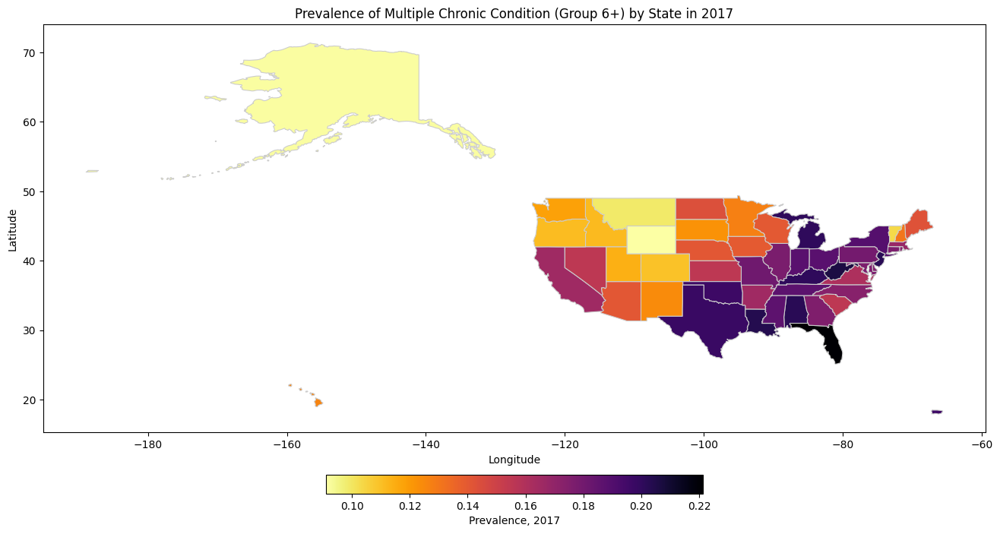

In [41]:
# Plot Prevalence on USA map
fig, ax = plt.subplots(figsize=(16, 12))

# Set the color map
cmap = 'inferno_r'

# Plot the choropleth map using 'plot()' function of GeoDataFrame
merged_state_gdf.plot(column='Prevalence', cmap=cmap, linewidth=0.8, ax=ax, edgecolor='0.8', legend=True,\
               legend_kwds={"label": "Prevalence, 2017", "orientation": "horizontal", "shrink" : 0.4, "pad": 0.06},)

# Customize the plot
ax.set_title('Prevalence of Multiple Chronic Condition (Group 6+) by State in 2017')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Display the plot
plt.show()

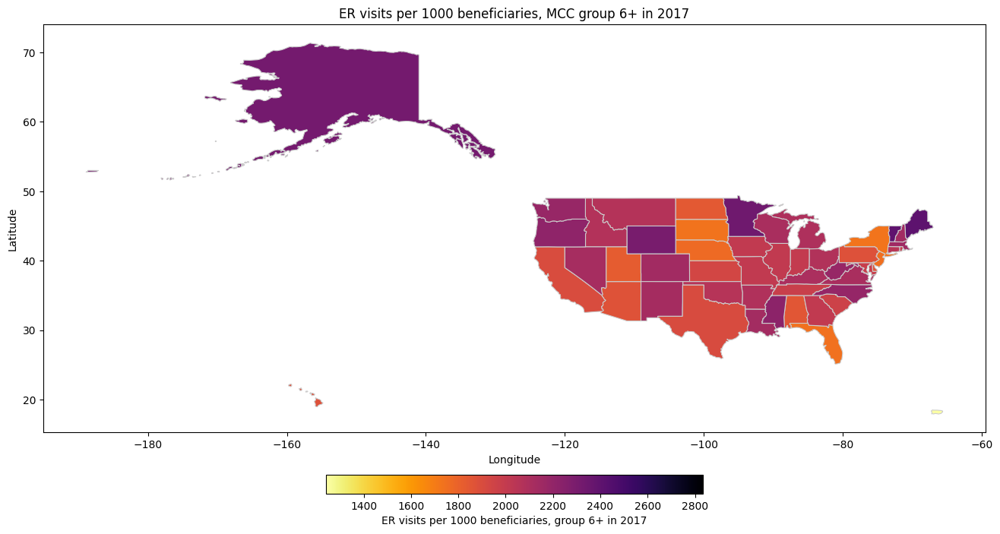

In [42]:
# Plot ER visits per 100 beneficiaries on USA map
fig, ax = plt.subplots(figsize=(16, 12))

# Set the color map
cmap = 'inferno_r'

# Plot the choropleth map using 'plot()' function of GeoDataFrame
merged_state_gdf.plot(column='Emergency_Room_Visits_per_1,000_Beneficiaries', cmap=cmap, linewidth=0.8, ax=ax, edgecolor='0.8', legend=True,\
               legend_kwds={"label": "ER visits per 1000 beneficiaries, group 6+ in 2017", "orientation": "horizontal", "shrink" : 0.4, "pad": 0.06},)

# Customize the plot
ax.set_title('ER visits per 1000 beneficiaries, MCC group 6+ in 2017')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Display the plot
plt.show()

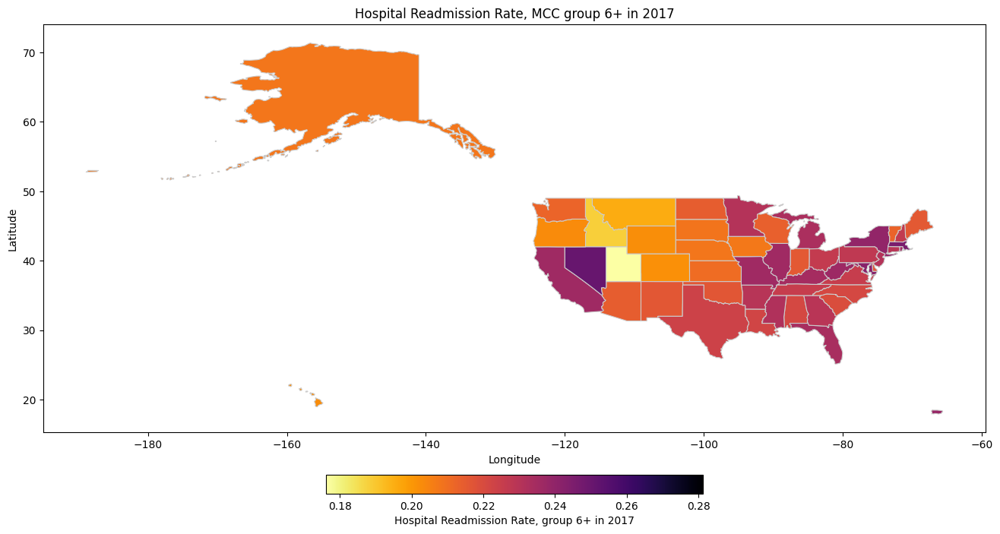

In [44]:
# Plot Hospital_Readmission_Rate on USA map
fig, ax = plt.subplots(figsize=(16, 12))

# Set the color map
cmap = 'inferno_r'

# Plot the choropleth map using 'plot()' function of GeoDataFrame
merged_state_gdf.plot(column='Hospital_Readmission_Rate', cmap=cmap, linewidth=0.8, ax=ax, edgecolor='0.8', legend=True,\
               legend_kwds={"label": "Hospital Readmission Rate, group 6+ in 2017", "orientation": "horizontal", "shrink" : 0.4, "pad": 0.06},)

# Customize the plot
ax.set_title('Hospital Readmission Rate, MCC group 6+ in 2017')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Display the plot
plt.show()

In [46]:
# Filtering for 'All' at state level
mcc_df_state_all_df = mcc_state_df.loc[(mcc_state_df["Beneficiary_Age_Level"] == "All") \
                                       & (mcc_state_df["Beneficiary_Demographic_Level"] == "All") \
                                       & (mcc_state_df["Beneficiary_Geographic_Level"] == "State"), :]
mcc_df_state_all_df.head()

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
0,State,Alabama,01,All,All,All,0 to 1,0.2621,2091.9398,1887.2548,0.0590,226.9723
1,State,Alabama,01,All,All,All,2 to 3,0.2874,5545.1296,5039.7988,0.0814,439.7410
2,State,Alabama,01,All,All,All,4 to 5,0.2481,10383.4301,9451.8262,0.1098,724.2161
3,State,Alabama,01,All,All,All,6+,0.2024,27980.7920,25491.2797,0.2212,1851.6498
4,State,Alaska,02,All,All,All,0 to 1,0.4805,1822.9275,2202.1402,0.0535,163.5787


In [47]:
# aggregate across all multiple chronic conditions counts, get mean for some columns
mcc_df_totals_for_states_df = mcc_df_state_all_df.groupby("Beneficiary_Geographic_Description")["Prevalence", "Hospital_Readmission_Rate", "Emergency_Room_Visits_per_1,000_Beneficiaries"].mean()
mcc_df_totals_for_states_df

,Prevalence,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
Beneficiary_Geographic_Description,,,
Alabama,0.250000,0.117850,810.644800
Alaska,0.250000,0.109375,996.158075
Arizona,0.250000,0.108350,779.631450
Arkansas,0.250000,0.120875,877.471125
California,0.249975,0.118900,792.351925
Colorado,0.250000,0.104100,927.395250
Connecticut,0.250025,0.118925,872.907150
Delaware,0.250000,0.107050,752.200925
District of Columbia,0.250000,0.154900,1164.459025


In [48]:
# aggregate across all multiple chronic conditions counts, get mean for some columns
mcc_df_totals_for_states_df = filtered_state_df.groupby("Beneficiary_Geographic_Description")["Prevalence", "Hospital_Readmission_Rate", "Emergency_Room_Visits_per_1,000_Beneficiaries"].mean()
mcc_df_totals_for_states_df.head()

,Prevalence,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
Beneficiary_Geographic_Description,,,
Alabama,0.250000,0.117850,810.644800
Alaska,0.250000,0.109375,996.158075
Arizona,0.250000,0.108350,779.631450
Arkansas,0.250000,0.120875,877.471125
California,0.249975,0.118900,792.351925


In [49]:
# get totals for others
mcc_df_totals_for_states_df[["Total_Medicare_Standardized_Per_Capita_Spending",\
                             "Total_Medicare_Per_Capita_Spending"]] = \
filtered_state_df.groupby("Beneficiary_Geographic_Description")["Total_Medicare_Standardized_Per_Capita_Spending",\
                                             "Total_Medicare_Per_Capita_Spending"].sum()
mcc_df_totals_for_states_df.head()

,Prevalence,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries",Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending
Beneficiary_Geographic_Description,,,,,
Alabama,0.250000,0.117850,810.644800,46001.2915,41870.1595
Alaska,0.250000,0.109375,996.158075,49365.1039,68164.6995
Arizona,0.250000,0.108350,779.631450,47904.0346,51545.0677
Arkansas,0.250000,0.120875,877.471125,48909.9955,45445.8171
California,0.249975,0.118900,792.351925,48356.1795,61124.0451


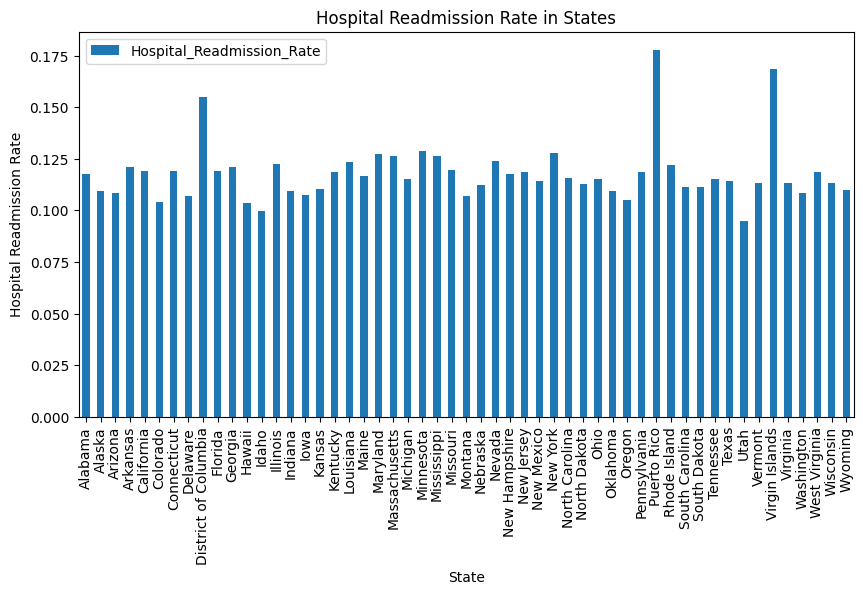

In [50]:
# Assuming mcc_df_totals_for_states_df is your DataFrame
fig, ax = plt.subplots(figsize=(10, 5))
mcc_df_totals_for_states_df[["Hospital_Readmission_Rate"]].plot.bar(
    xlabel="State", ylabel="Hospital Readmission Rate", ax=ax
)

# Customize other plot elements if needed
plt.title("Hospital Readmission Rate in States")

# Save the plot as a PNG image with the specified size
plt.savefig("images/fig_hospital_readmission_rate_in_states.png", dpi=300)

# Display the plot (optional if you don't want to show the plot in the notebook)
plt.show()

In [51]:
# grouping by state then age
#mcc_state_df = mcc_state_df.loc[mcc_state_df["Beneficiary_Geographic_Level"] == "State"]

mcc_state_by_age_df = mcc_df.loc[(mcc_df["Beneficiary_Geographic_Level"] == "State")\
                                          & (mcc_df["Beneficiary_Demographic_Level"] == "All") \
                                          & (mcc_df["Beneficiary_Age_Level"] != "All"), :]
print(mcc_state_by_age_df.shape)

(432, 12)


In [52]:
# Removing the unknown state from Beneficiary_Geographic_Description
filtered_state_by_age_df = mcc_state_by_age_df[mcc_state_by_age_df["Beneficiary_Geographic_Description"] != "Unknown"]
print(filtered_state_by_age_df.shape)

(424, 12)


In [53]:
# Adding the state code of Puerto Rico and Virgin islands
# this function would replace for null or blank values
# Define a mapping dictionary for the replacements
state_code_mapping = {
    "Puerto Rico": "72",
    "Virgin Islands": "78"
}

# Use numpy.where() to replace blanks based on conditions
filtered_state_by_age_df['Beneficiary_Geographic_Code'] = np.where(filtered_state_by_age_df['Beneficiary_Geographic_Code'].isnull() | filtered_state_by_age_df['Beneficiary_Geographic_Code'].eq(''), 
                            filtered_state_by_age_df['Beneficiary_Geographic_Description'].map(state_code_mapping), 
                            filtered_state_by_age_df['Beneficiary_Geographic_Code'])
print(filtered_state_by_age_df.shape)

(424, 12)


In [54]:
# Drop rows with blanks in the specified column
columns_to_drop = ["Beneficiary_Geographic_Description", "Prevalence", \
                   "Total_Medicare_Standardized_Per_Capita_Spending", \
                   "Total_Medicare_Per_Capita_Spending", "Hospital_Readmission_Rate", \
                   "Emergency_Room_Visits_per_1,000_Beneficiaries"]

filtered_state_by_age_df.dropna(subset=columns_to_drop, inplace=True)
print(filtered_state_by_age_df.shape)

(414, 12)


In [55]:
# aggregate across all multiple chronic conditions counts, get mean for some columns
mcc_df_state_by_age_aggregate_example_df = filtered_state_by_age_df.groupby(["Beneficiary_Geographic_Description","Beneficiary_Age_Level"])["Emergency_Room_Visits_per_1,000_Beneficiaries"].mean()
mcc_df_state_by_age_aggregate_example_df

Beneficiary_Geographic_Description  Beneficiary_Age_Level
Alabama                             65+                       651.554550
                                    <65                      1453.301850
Alaska                              65+                       852.459750
                                    <65                      1833.467725
Arizona                             65+                       712.020200
                                    <65                      1558.472925
Arkansas                            65+                       752.685525
                                    <65                      1486.478100
California                          65+                       679.138050
                                    <65                      1556.787575
Colorado                            65+                       789.501950
                                    <65                      1847.273750
Connecticut                         65+                       752.

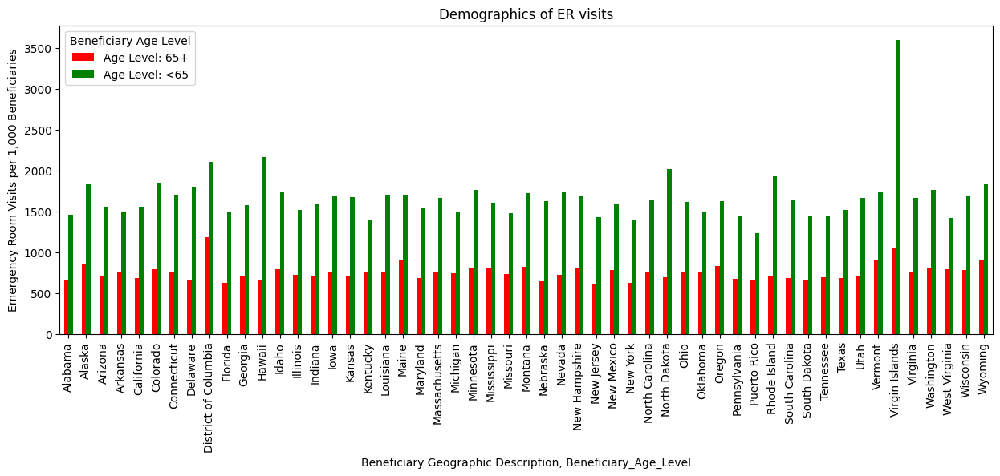

In [56]:
# Plot the bar chart using pandas
ax = mcc_df_state_by_age_aggregate_example_df.unstack('Beneficiary_Age_Level').plot.bar(
    color=['r', 'g'], figsize=(15, 5)
)

# Set the labels for the legend based on the 'Beneficiary_Age_Level' category
age_levels = mcc_df_state_by_age_aggregate_example_df.index.get_level_values('Beneficiary_Age_Level').unique()

legend_labels = [f"Age Level: {age}" for age in age_levels]

# Get the current legend handles and labels
handles, _ = ax.get_legend_handles_labels()

# Create a new legend with the desired labels
ax.legend(handles, legend_labels, title="Beneficiary Age Level")

# Customize other plot elements if needed
plt.title("Demographics of ER visits")
plt.xlabel("Beneficiary Geographic Description, Beneficiary_Age_Level")
plt.ylabel("Emergency Room Visits per 1,000 Beneficiaries")

# Show the plot
plt.show()


## Basic analysis on overall state data

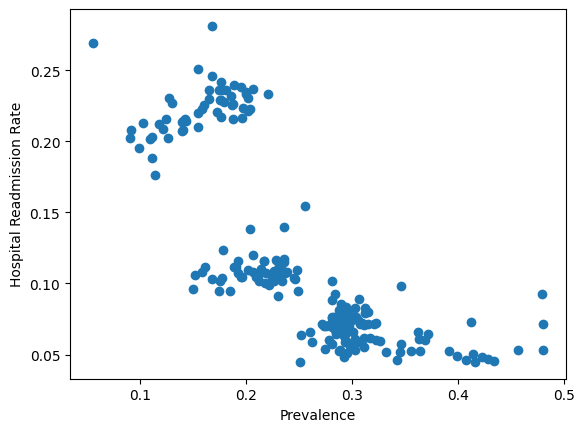

In [57]:
# Relationship between Prevalence and the rate of hospitalization for MCC
plt.scatter(mcc_state_df['Prevalence'], mcc_state_df['Hospital_Readmission_Rate'])
plt.xlabel('Prevalence')
plt.ylabel('Hospital Readmission Rate')
plt.show()

In [58]:
# aggregate across all multiple chronic conditions counts, get mean for some columns
mcc_df_state_by_age_aggregate_hosp_admit_df = filtered_state_by_age_df.groupby(["Beneficiary_Geographic_Description","Beneficiary_Age_Level"])["Hospital_Readmission_Rate"].mean()
mcc_df_state_by_age_aggregate_hosp_admit_df

Beneficiary_Geographic_Description  Beneficiary_Age_Level
Alabama                             65+                      0.101500
                                    <65                      0.155400
Alaska                              65+                      0.101275
                                    <65                      0.142875
Arizona                             65+                      0.099975
                                    <65                      0.164275
Arkansas                            65+                      0.108950
                                    <65                      0.156400
California                          65+                      0.105525
                                    <65                      0.168600
Colorado                            65+                      0.093450
                                    <65                      0.152350
Connecticut                         65+                      0.103875
                                

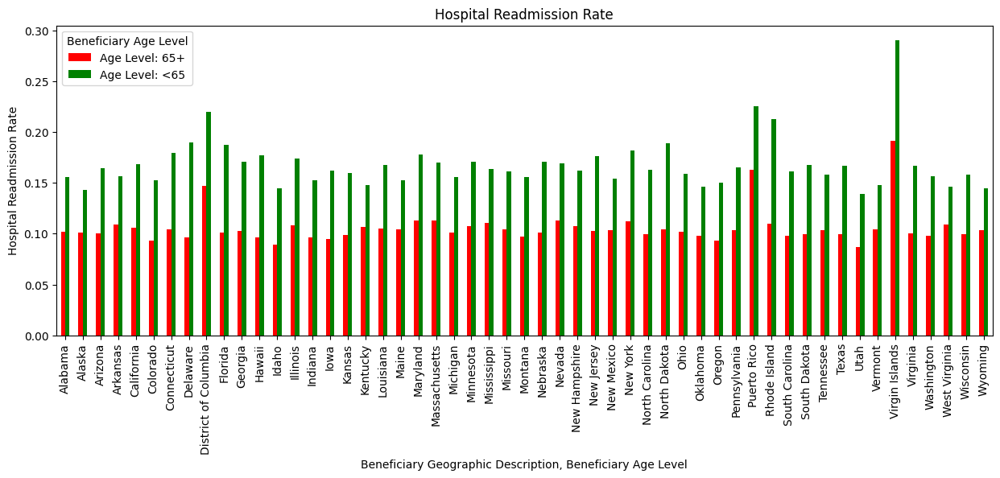

In [59]:
# Plot the bar chart using pandas
ax = mcc_df_state_by_age_aggregate_hosp_admit_df.unstack('Beneficiary_Age_Level').plot.bar(
    color=['r', 'g'], figsize=(15, 5)
)

# Set the labels for the legend based on the 'Beneficiary_Age_Level' category
age_levels = mcc_df_state_by_age_aggregate_hosp_admit_df.index.get_level_values('Beneficiary_Age_Level').unique()

legend_labels = [f"Age Level: {age}" for age in age_levels]

# Get the current legend handles and labels
handles, _ = ax.get_legend_handles_labels()

# Create a new legend with the desired labels
ax.legend(handles, legend_labels, title="Beneficiary Age Level")

# Customize other plot elements if needed
plt.title("Hospital Readmission Rate")
plt.xlabel("Beneficiary Geographic Description, Beneficiary Age Level")
plt.ylabel("Hospital Readmission Rate")

# Show the plot
plt.show()


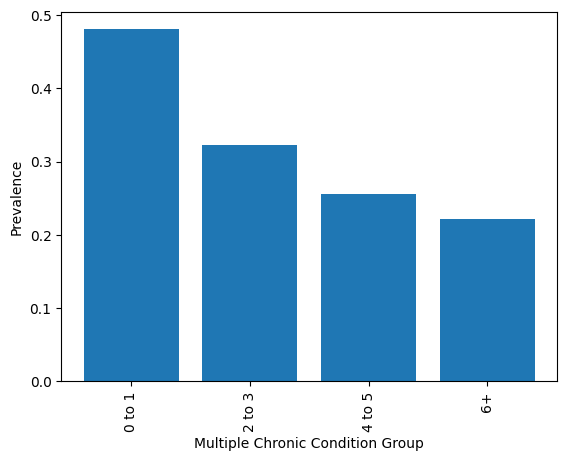

In [61]:
# Showing the relationship between the cases of MCC levels and prevalence of MCC
plt.bar(mcc_state_df['Beneficiary_Multiple_Chronic_Condition_Group'],mcc_state_df['Prevalence'])
plt.xlabel("Multiple Chronic Condition Group")
plt.xticks(rotation=90)
plt.ylabel("Prevalence")
plt.show()

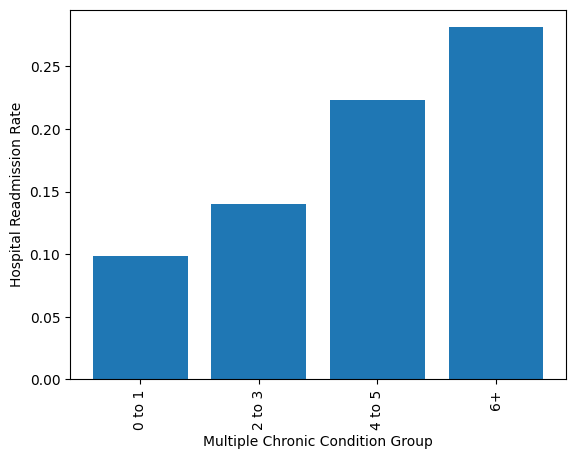

In [62]:
# Showing the relationship between the cases of MCC levels and Hospital_Readmission_Rate
plt.bar(mcc_state_df['Beneficiary_Multiple_Chronic_Condition_Group'], mcc_state_df['Hospital_Readmission_Rate'])
plt.xlabel("Multiple Chronic Condition Group")
plt.xticks(rotation=90)
plt.ylabel("Hospital Readmission Rate")
plt.show()

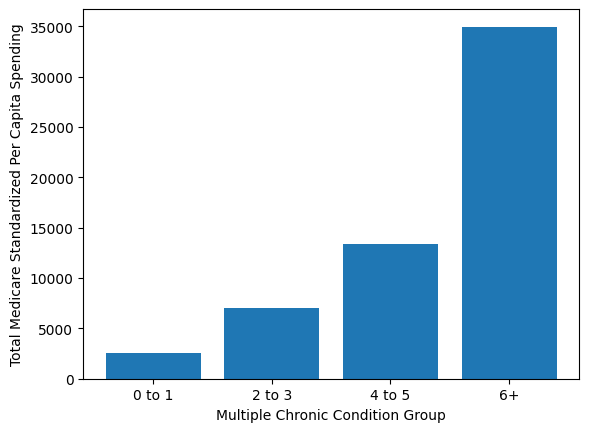

In [63]:
# Showing the relationship between the cases of MCC levels and Total_Medicare_Standardized_Per_Capita_Spending
plt.bar(mcc_state_df['Beneficiary_Multiple_Chronic_Condition_Group'], mcc_state_df['Total_Medicare_Standardized_Per_Capita_Spending'])
plt.xlabel("Multiple Chronic Condition Group")
plt.ylabel("Total Medicare Standardized Per Capita Spending")
plt.show()

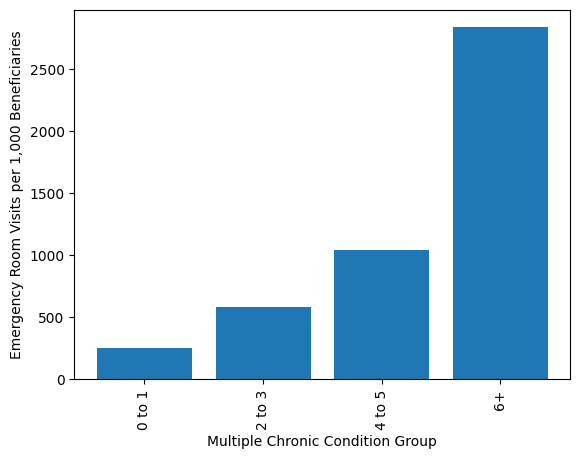

In [64]:
# Showing the relationship between the cases of MCC levels and Emergency_Room_Visits_per_1,000_Beneficiaries
plt.bar(mcc_state_df['Beneficiary_Multiple_Chronic_Condition_Group'], mcc_state_df['Emergency_Room_Visits_per_1,000_Beneficiaries'])
plt.xlabel("Multiple Chronic Condition Group")
plt.xticks(rotation=90)
plt.ylabel("Emergency Room Visits per 1,000 Beneficiaries")
plt.show()

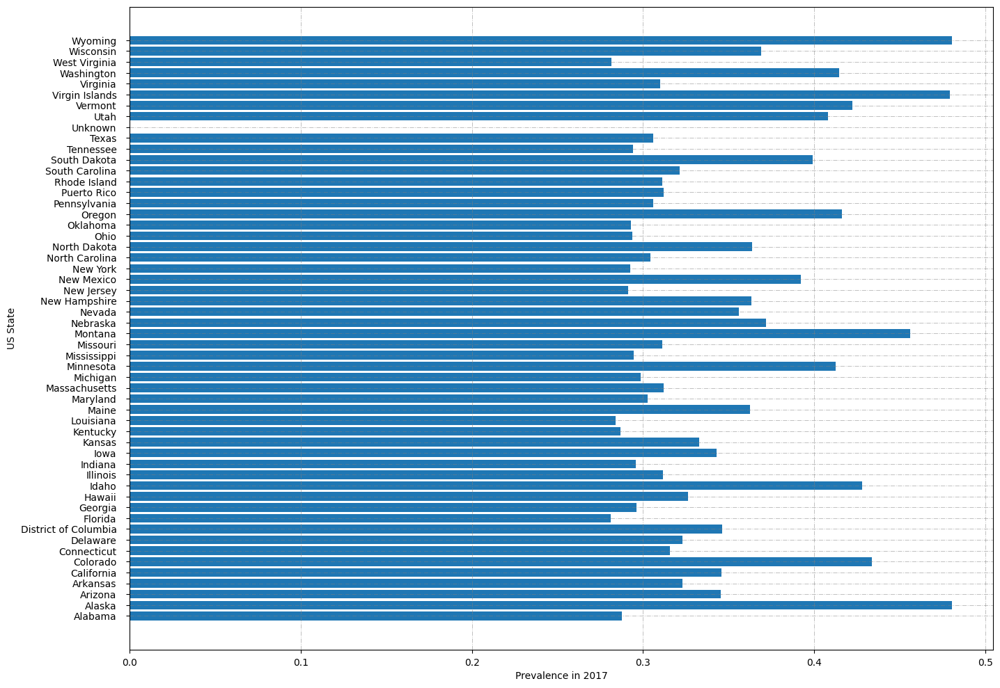

In [65]:
# Observing prevalence vs state
fig, ax = plt.subplots(figsize =(16, 12))
 
# Horizontal Bar Plot
ax.barh(mcc_state_df["Beneficiary_Geographic_Description"], mcc_state_df["Prevalence"])

# Add axis labels
plt.xlabel("Prevalence in 2017")
plt.ylabel("US State")

# Add gridlines
ax.grid(color ='grey',
        linestyle ='-.', linewidth = 0.7,
        alpha = 0.5)
    
# Add padding between axes and labels
ax.xaxis.set_tick_params(pad = 5)
ax.yaxis.set_tick_params(pad = 10)
plt.savefig("images/Fig_prevalence_vs_state.png")
plt.show()


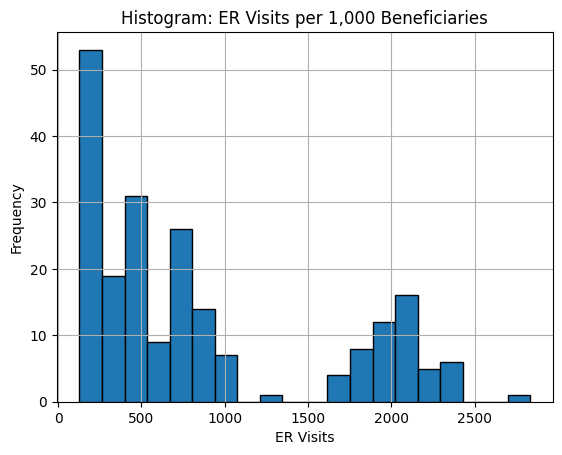

In [66]:
# Filter out negative values in the 'Emergency_Room_Visits_per_1,000_Beneficiaries' column
mcc_state_df_filtered = mcc_state_df[mcc_state_df['Emergency_Room_Visits_per_1,000_Beneficiaries'] >= 0]

# Create the histogram
plt.hist(mcc_state_df_filtered['Emergency_Room_Visits_per_1,000_Beneficiaries'], bins=20, edgecolor='black')

# Add labels and title
plt.xlabel("ER Visits")
plt.ylabel("Frequency")
plt.title("Histogram: ER Visits per 1,000 Beneficiaries")

# Add grid lines to the plot
plt.grid(True)

# Show the plot
plt.show()

### Observing the dataset at county level

In [67]:
# Make a dataframe based on County
mcc_county_df = mcc_df.loc[mcc_df["Beneficiary_Geographic_Level"] == "County"]
mcc_county_df = mcc_county_df.reset_index(drop=True)
mcc_county_df

,Beneficiary_Geographic_Level,Beneficiary_Geographic_Description,Beneficiary_Geographic_Code,Beneficiary_Age_Level,Beneficiary_Demographic_Level,Beneficiary_Demographic_Description,Beneficiary_Multiple_Chronic_Condition_Group,Prevalence,Total_Medicare_Standardized_Per_Capita_Spending,Total_Medicare_Per_Capita_Spending,Hospital_Readmission_Rate,"Emergency_Room_Visits_per_1,000_Beneficiaries"
0,County,Alabama : Autauga,01001,All,All,All,0 to 1,0.2746,2210.4664,1986.1032,NaN,206.1495
1,County,Alabama : Autauga,01001,All,All,All,2 to 3,0.2795,5779.4177,5124.0744,NaN,411.1187
2,County,Alabama : Autauga,01001,All,All,All,4 to 5,0.2477,9715.1652,8746.9833,0.0751,739.7366
3,County,Alabama : Autauga,01001,All,All,All,6+,0.1982,29804.7963,26863.0748,0.2564,2244.9177
4,County,Alabama : Baldwin,01003,All,All,All,0 to 1,0.2821,2100.8820,1916.7417,NaN,129.1382
5,County,Alabama : Baldwin,01003,All,All,All,2 to 3,0.3072,5657.0170,5151.9363,0.0693,320.9799
6,County,Alabama : Baldwin,01003,All,All,All,4 to 5,0.2373,10472.4830,9474.2392,0.0969,613.3073
7,County,Alabama : Baldwin,01003,All,All,All,6+,0.1734,25754.3856,23004.7191,0.1997,1635.5744
8,County,Alabama : Barbour,01005,All,All,All,0 to 1,0.2463,2129.0116,1984.3717,0.0000,349.8513
9,County,Alabama : Barbour,01005,All,All,All,2 to 3,0.3046,5238.2223,4797.4047,NaN,513.6218


In [ ]:
# Filtering for 'All' at county level
mcc_county_by_age_df = mcc_df.loc[(mcc_df["Beneficiary_Geographic_Level"] == "State")\
                                          & (mcc_df["Beneficiary_Demographic_Level"] == "All") \
                                          & (mcc_df["Beneficiary_Age_Level"] == "All"), :]
print(mcc_state_by_age_df.shape)

In [ ]:
# creating a County column from the Beneficiary_Geographic_Description column
mcc_county_df["Beneficiary_Geographic_County"] = mcc_county_df["Beneficiary_Geographic_Description"].str.split(": ").str[1]
mcc_county_df

In [ ]:
# converting the datatype of Beneficiary_Geographic_Code
mcc_county_df["Beneficiary_Geographic_Code"] = mcc_county_df["Beneficiary_Geographic_Code"].apply(pd.to_numeric, errors='coerce')
mcc_county_df.info()

In [ ]:
# creating a State code from Beneficiary_Geographic_Code to merge with geojson data later
# Using floor division to extract the State code
mcc_county_df.loc[:,"State_Code"] = mcc_county_df["Beneficiary_Geographic_Code"] // 1000
mcc_county_df

In [ ]:
# Drop rows with blanks in the specified columns
columns_to_drop = ["Beneficiary_Geographic_Description", "Prevalence", \
                   "Total_Medicare_Standardized_Per_Capita_Spending", \
                   "Total_Medicare_Per_Capita_Spending", "Hospital_Readmission_Rate", \
                   "Emergency_Room_Visits_per_1,000_Beneficiaries"]

mcc_county_df.dropna(subset=columns_to_drop, inplace=True)
mcc_county_df

In [ ]:
# Rearranging the columns of mcc_county_df
mcc_county_df = mcc_county_df[["Beneficiary_Geographic_Level", "Beneficiary_Geographic_Description", \
                               "State_Code", "Beneficiary_Geographic_County", "Beneficiary_Geographic_Code", \
                               "Beneficiary_Age_Level", "Beneficiary_Demographic_Level", \
                               "Beneficiary_Demographic_Description", "Beneficiary_Multiple_Chronic_Condition_Group", 
                               "Prevalence", "Total_Medicare_Standardized_Per_Capita_Spending", \
                               "Total_Medicare_Per_Capita_Spending", "Hospital_Readmission_Rate", \
                               "Emergency_Room_Visits_per_1,000_Beneficiaries"]]
mcc_county_df

In [ ]:
# converting State_Code and Beneficiary_Geographic_Code back to str object dtype
mcc_county_df["State_Code"] = mcc_county_df["State_Code"].apply(str)
mcc_county_df["Beneficiary_Geographic_Code"] = mcc_county_df["Beneficiary_Geographic_Code"].apply(str)

mcc_county_df.describe()

In [ ]:
mcc_county_df.info()

In [ ]:
# testing with new geojson
jsonData = requests.get("https://eric.clst.org/assets/wiki/uploads/Stuff/gz_2010_us_050_00_500k.json").json()
gdf = gpd.GeoDataFrame(jsonData)
gdf2 = gpd.GeoDataFrame.from_features(gdf['features'])
gdf2 = gdf2.explode()
gdf2

In [ ]:
# Load the json file with county coordinates
geoData = gpd.read_file('https://raw.githubusercontent.com/holtzy/The-Python-Graph-Gallery/master/static/data/US-counties.geojson')
geoData

In [ ]:
geoData.info()

In [ ]:
# testing with new json file
# add the json to into mcc_county dataset
merged_df = mcc_county_df.merge(gdf2, left_on=["State_Code", "Beneficiary_Geographic_County"], right_on=["STATE","NAME"])

# we need to deal with pesky multipolygons
merged_df = merged_df.explode("geometry")
merged_df

In [ ]:
# add the json to into mcc_county dataset
merged_df = mcc_county_df.merge(geoData, left_on=["State_Code", "Beneficiary_Geographic_County"], right_on=["STATE","NAME"])

# we need to deal with pesky multipolygons
merged_df = merged_df.explode("geometry")
merged_df

In [ ]:
# Specifying the `total_bounds` 
merged_gdf = gpd.GeoDataFrame(merged_df)
bounds = merged_gdf.total_bounds
print(bounds)

# Check for valid geometries
print(merged_gdf.geometry.is_valid)

In [ ]:
# testing 
# Plot Prevalence on USA map
fig, ax = plt.subplots(figsize=(16, 12))

# Set the color map ('inferno_r' is just an example, you can choose other colormaps)
cmap = 'inferno_r'

# Plot the choropleth map using 'plot()' function of GeoDataFrame
merged_gdf.plot(column='Prevalence', cmap=cmap, linewidth=0.8, ax=ax, edgecolor='0.8', legend=True,\
               legend_kwds={"label": "Prevalence in 2017", "orientation": "horizontal"},)

# Customize the plot
ax.set_title('Prevalence Map by County')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Display the plot
plt.show()

In [ ]:
# Write county df to a csv file
merged_gdf.to_csv('mcc_county_merged_geometry.csv', index = False)

In [ ]:
# Plot Prevalence on USA map
fig, ax = plt.subplots(figsize=(16, 12))

# Set the color map ('inferno_r' is just an example, you can choose other colormaps)
cmap = 'inferno_r'

# Plot the choropleth map using 'plot()' function of GeoDataFrame
merged_gdf.plot(column='Prevalence', cmap=cmap, linewidth=0.8, ax=ax, edgecolor='0.8', legend=True,\
               legend_kwds={"label": "Prevalence in 2017", "orientation": "horizontal"},)

# Customize the plot
ax.set_title('Prevalence Map by County')
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

# Display the plot
plt.show()

## References
https://www.statology.org/pandas-convert-object-to-float/

https://geopandas.org/en/stable/docs/user_guide/mapping.html
    